In [1]:
%load_ext autoreload
%autoreload 2

from pathlib import Path
import sys
import random
import matplotlib.pyplot as plt
import numpy as np
import keras

CURRENT_DIR = Path('/content/drive')
from google.colab import drive
drive.mount(str(CURRENT_DIR))

CURRENT_DIR = CURRENT_DIR.joinpath('MyDrive','restauracion')
MODULES_DIR = CURRENT_DIR.joinpath('src')
sys.path.append(str(MODULES_DIR))
DATA_DIR = CURRENT_DIR.joinpath('Process','DATA_SET_ENTRENAMIENTO')

%config InlineBackend.figure_format = 'retina'
import tensorflow as tf
from keras.models import Model, load_model

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
autoencoder = load_model(str(DATA_DIR.parent.parent.joinpath('models','modelo_v_4_2.h5')))

In [3]:
x_input, y_input = 1200,850


In [4]:
from sklearn.model_selection import train_test_split
from keras.utils import img_to_array, load_img

In [5]:
files_clean = sorted([f for f in DATA_DIR.joinpath('CLEAN').iterdir() if f.is_file()])
files_clean = sorted(files_clean)

In [6]:
files_noisy = sorted([f for f in DATA_DIR.joinpath('BLURR').iterdir() if f.is_file()])
files_noisy = sorted(files_noisy)

In [7]:
x_train_list, x_test_list, y_train_list, y_test_list = train_test_split(
    files_noisy,
    files_clean,
    test_size=0.2
)

In [8]:
import data_load

In [9]:
trainning_generator = data_load.CustomImageDataGenerator(
    image_paths_noisy=x_train_list,
    image_paths_clean=y_train_list,
    batch_size=8,
    target_size=(x_input, y_input),
    class_mode='input',
    shuffle=True)


testing_generator = data_load.CustomImageDataGenerator(
    image_paths_noisy=x_test_list,
    image_paths_clean=y_test_list,
    batch_size=8,
    target_size=(x_input, y_input),
    class_mode='input',
    shuffle=True)

In [11]:
from tensorflow.keras.preprocessing.image import array_to_img

In [17]:
x,y = testing_generator.__getitem__(random.randint(0,100))
output1 = autoencoder.predict(y)

1/1 [==============================] - 32s 32s/step


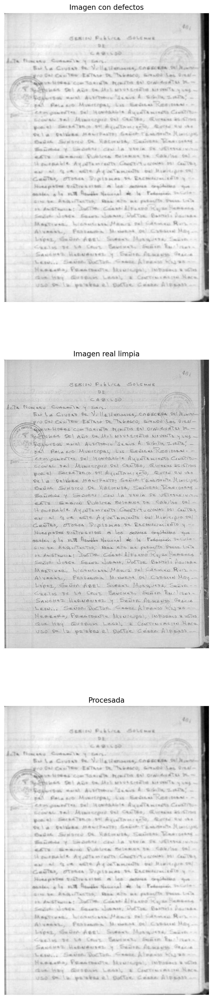

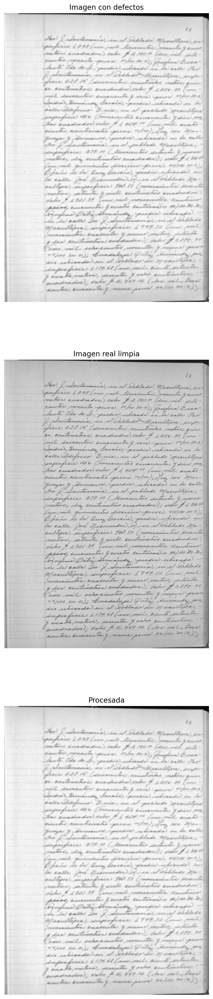

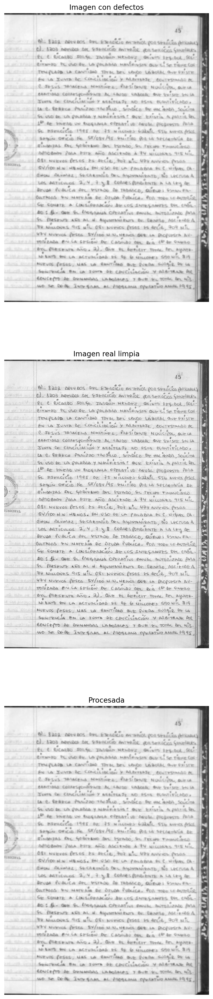

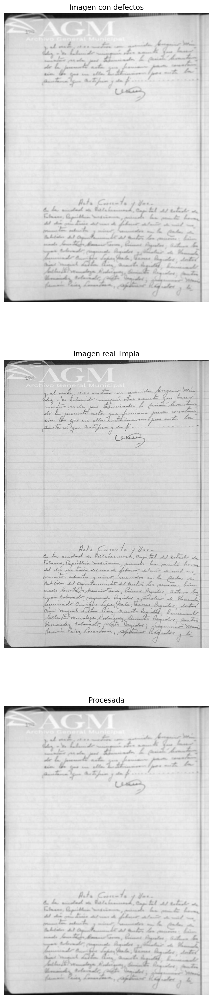

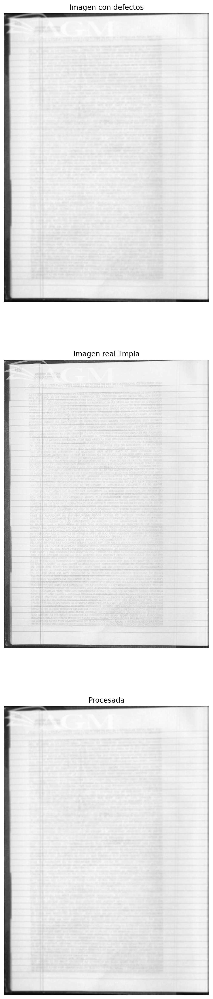

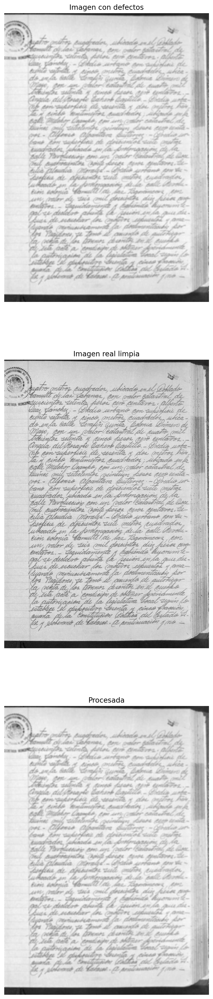

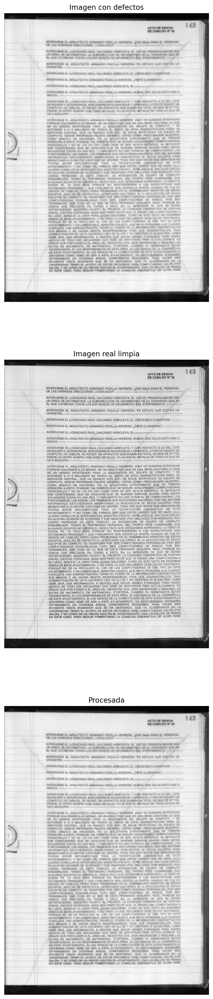

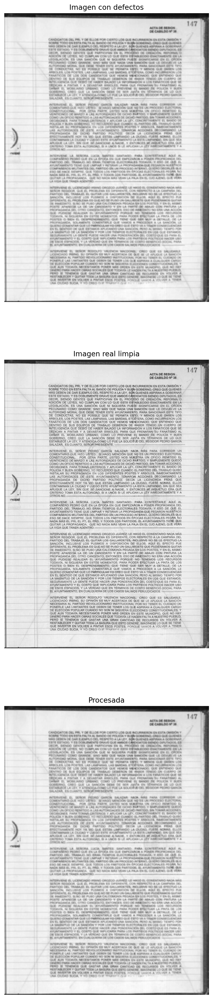

In [18]:
for i in range(8):
    fig, ax = plt.subplots(3,1, figsize=(15,30))

    a1 = array_to_img(np.array(x[i] * 255, dtype=np.uint8))
    ax[0].imshow(a1, cmap='gray')
    ax[0].set_title('Imagen con defectos')
    ax[0].axis(False)

    a2 = array_to_img(np.array(y[i] * 255, dtype=np.uint8))
    ax[1].imshow(a2,cmap='gray')
    ax[1].set_title('Imagen real limpia')
    ax[1].axis(False)

    a3 = array_to_img(np.array(output1[i] * 255, dtype=np.uint8))
    ax[2].imshow(a1,cmap='gray')
    ax[2].set_title('Procesada')
    ax[2].axis(False)
    plt.show()